In [2]:
# resorces 
# the covid-19 data provided by johns-hopkins-university 
# https://github.com/CSSEGISandData/COVID-19.git  

# for the world population
# https://worldpopulationreview.com/countries

# for the shapefile 
# https://drive.google.com/drive/folders/16Y3vUcsbv8trPQ4WnbA-5sf4o0iAdPyq?usp=sharing

In [3]:
import os , wget
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium import plugins
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import iplot,init_notebook_mode
init_notebook_mode()

In [4]:
# # getting recuired files from the internet
# # if the shape file and population exists it will skip it because it is a static file with no time cahnging effect
# if os.path.exists(r'shapefile'):
#     urls = ['https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv', 
#             'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv',
#             'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv']

# else:
#     urls = ['https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv', 
#         'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv',
#         'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv',
#         'https://worldpopulationreview.com/6920457a-ffb5-4e14-adcf-6f34c95c823a',
#         'https://drive.google.com/drive/folders/16Y3vUcsbv8trPQ4WnbA-5sf4o0iAdPyq?usp=sharing']

# ! rm *.csv
# for url in urls: filename = wget.download(url)


In [5]:
df_confirmed = pd.read_csv(r'time_series_covid19_confirmed_global.csv')
df_death = pd.read_csv(r'time_series_covid19_deaths_global.csv')
df_recovered = pd.read_csv(r'time_series_covid19_recovered_global.csv')
world = gpd.read_file(r'input\World_Map.shp')
pop = pd.read_csv(r'input\csvData.csv')

In [6]:
df_cor = df_confirmed[['Country/Region','Lat','Long']]

In [7]:
# getting the dates
dates = df_confirmed.columns[4:]

# melt dataframes into pivot like dataframes
df_confirmed_melt = df_confirmed.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Confirmed')

df_death_melt = df_death.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Deaths')

df_recovered_melt = df_recovered.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Recovered')


print(df_confirmed_melt.shape)
print(df_death_melt.shape)
print(df_recovered_melt.shape)

(163494, 6)
(163494, 6)
(154704, 6)


In [8]:
# mergging dataframes to get all values togther
df = pd.merge(left=df_confirmed_melt, right=df_death_melt, how='left',
                      on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long'])

df = pd.merge(left=df, right=df_recovered_melt, how='left',
                      on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long'])

df.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.93911,67.709953,1/22/20,0,0,0.0
1,NaN,Albania,41.15330,20.168300,1/22/20,0,0,0.0
2,NaN,Algeria,28.03390,1.659600,1/22/20,0,0,0.0
3,NaN,Andorra,42.50630,1.521800,1/22/20,0,0,0.0
4,NaN,Angola,-11.20270,17.873900,1/22/20,0,0,0.0


In [9]:
# Convert to date format
df['Date'] = pd.to_datetime(df['Date'])

# fill null with 0
df['Recovered'] = df['Recovered'].fillna(0)

# converting the Recovered column into int datatype
df['Recovered'] = df['Recovered'].astype('int')

# removing extra recovered values from the merge
df = df[df['Province/State'].str.contains('Recovered')!=True]

# removing county wise data to avoid double values
df = df[df['Province/State'].str.contains(',')!=True]

# creating an Active column for analysis 
df['Active'] = df['Confirmed'] - df['Deaths'] - df['Recovered']

cols = ['Confirmed', 'Deaths', 'Recovered', 'Active']
df[cols] = df[cols].fillna(0)
df.info()
df.sample(5)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 162322 entries, 0 to 163493
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Province/State  49810 non-null   object        
 1   Country/Region  162322 non-null  object        
 2   Lat             161150 non-null  float64       
 3   Long            161150 non-null  float64       
 4   Date            162322 non-null  datetime64[ns]
 5   Confirmed       162322 non-null  int64         
 6   Deaths          162322 non-null  int64         
 7   Recovered       162322 non-null  int32         
 8   Active          162322 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int32(1), int64(3), object(2)
memory usage: 11.8+ MB


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active
9322,NaN,Eswatini,-26.522500,31.465900,2020-02-24,0,0,0,0
82583,NaN,Zimbabwe,-19.015438,29.154857,2020-11-12,8696,255,8060,381
4683,NaN,Saint Kitts and Nevis,17.357822,-62.782998,2020-02-07,0,0,0,0
65665,NaN,Cyprus,35.126400,33.429900,2020-09-13,1526,22,1281,223
150163,Fujian,China,26.078900,117.987400,2021-07-13,699,1,657,41


In [10]:
# Groupping by day, country for improving the quality of the data 
full_grouped = df.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()

# creating the new cases columns
temp = full_grouped.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths', 'Recovered']
temp = temp.sum().diff().reset_index()

mask = temp['Country/Region'] != temp['Country/Region'].shift(1)

temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan
temp.loc[mask, 'Recovered'] = np.nan

# renaming columns 
temp.columns = ['Country/Region', 'Date', 'New cases', 'New deaths', 'New recovered']

# merging new values
full_grouped = pd.merge(full_grouped, temp, on=['Country/Region', 'Date'])

# filling na with 0
full_grouped = full_grouped.fillna(0)

# fixing data types
cols = ['New cases', 'New deaths', 'New recovered']
full_grouped[cols] = full_grouped[cols].astype('int')

full_grouped['New cases'] = full_grouped['New cases'].apply(lambda x: 0 if x<0 else x)

full_grouped = full_grouped.groupby(['Date','Country/Region'])['Confirmed', 'Deaths', 'Recovered','New cases', 'New deaths', 'New recovered'].sum().reset_index()

# mergging dataframes for adding latitude and longitude 
full_grouped = pd.merge(left=full_grouped, right=df_cor, how='left', on=['Country/Region'])

# renaming columns
full_grouped.rename(columns={'Country/Region':'Country'},inplace=True)

full_grouped = full_grouped[full_grouped.Country!='Diamond Princess']
full_grouped = full_grouped[full_grouped.Country!='MS Zaandam']
full_grouped = full_grouped[full_grouped.Country!='Summer Olympics 2020']

# droping two null values in china and in canada and renaming DataFrame
df = full_grouped.dropna()


C:\Users\samer\anaconda3\envs\open_source\lib\site-packages\ipykernel_launcher.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\samer\anaconda3\envs\open_source\lib\site-packages\ipykernel_launcher.py:5: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\samer\anaconda3\envs\open_source\lib\site-packages\ipykernel_launcher.py:29: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [11]:
# checking the data online for validating data 
df[df['Country'].str.contains('Egypt')]

## all of the columns match except the New recovered 

,Date,Country,Confirmed,Deaths,Recovered,New cases,New deaths,New recovered,Lat,Long
110,2020-01-22,Egypt,0,0,0,0,0,0,26.820553,30.802498
389,2020-01-23,Egypt,0,0,0,0,0,0,26.820553,30.802498
668,2020-01-24,Egypt,0,0,0,0,0,0,26.820553,30.802498
947,2020-01-25,Egypt,0,0,0,0,0,0,26.820553,30.802498
1226,2020-01-26,Egypt,0,0,0,0,0,0,26.820553,30.802498
...,...,...,...,...,...,...,...,...,...,...
162209,2021-08-25,Egypt,286938,16691,0,203,8,0,26.820553,30.802498
162488,2021-08-26,Egypt,287159,16701,0,221,10,0,26.820553,30.802498
162767,2021-08-27,Egypt,287393,16706,0,234,5,0,26.820553,30.802498
163046,2021-08-28,Egypt,287644,16714,0,251,8,0,26.820553,30.802498


In [12]:
# dropping islands that can affect the data
# df = df[df.State!='Grand Princess'] 
# df = df[df.State!='Diamond Princess']
df = df[df.Country!='Diamond Princess']
df = df[df.Country!='MS Zaandam']
df = df[df.Country!='Summer Olympics 2020']

In [13]:
# This places doesn't have population data 
# Åland Islands, Bouvet Island, British Indian Ocean Territory, Cocos (Keeling) Islands, French Southern and Antarctic Lands, 
# Guernsey, Heard Island and McDonald Islands, Jersey islands, Netherlands Antilles, Norfolk Island, 
# Pitcairn Islands, Saint Helena, Svalbard, United States Minor Outlying Islands, Wallis and Futuna Islands

In [14]:
# the population data didn't match the Country names 
## editing the population data names to match the Country names
pop.replace('Bouvet Island', '', inplace = True)
pop.replace('Brunei', 'Brunei Darussalam', inplace = True)
pop.replace('Myanmar', 'Burma', inplace = True)
pop.replace('Darussalam', '', inplace = True)
pop.replace('DR Congo', 'Democratic Republic of the Congo', inplace = True)
pop.replace('Republic of the Congo', 'Congo', inplace = True)
pop.replace('Ivory Coast', "Cote d'Ivoire", inplace = True)
pop.replace('Falkland Islands', 'Falkland Islands (Malvinas)', inplace = True)
pop.replace('Vatican City', 'Holy See (Vatican City)', inplace = True)
pop.replace('Iran', 'Iran (Islamic Republic of)', inplace = True)
pop.replace('North Korea', "Korea, Democratic People's Republic of", inplace = True)
pop.replace('South Korea', 'Korea, Republic of', inplace = True)
pop.replace('Laos', "Lao People's Democratic Republic", inplace = True)
pop.replace('Libya', 'Libyan Arab Jamahiriya', inplace = True)
pop.replace('Micronesia', 'Micronesia, Federated States of', inplace = True)
pop.replace('Moldova', 'Republic of Moldova', inplace = True)
pop.replace('Eswatini', 'Swaziland', inplace = True)
pop.replace('Syria', 'Syrian Arab Republic', inplace = True)
pop.replace('North Macedonia', 'The former Yugoslav Republic of Macedonia', inplace = True)
pop.replace('Tanzania', 'United Republic of Tanzania', inplace = True)
pop.replace('Vietnam', 'Viet Nam', inplace = True)

# matching the column's name for a better match
pop.rename(columns={'name':'Country'},inplace=True)
world.rename(columns={'NAME':'Country'},inplace=True)

# Merging the 'pop' with 'world' geopandas geodataframe
world = world.merge(pop,on=['Country'])

In [15]:
# the shapefile data didn't match the DataFrame
## editing the Country names to match the DataFrame
world.replace('Viet Nam', 'Vietnam', inplace = True)
world.replace('Brunei Darussalam', 'Brunei', inplace = True)
world.replace('Cape Verde', 'Cabo Verde', inplace = True)
world.replace('Democratic Republic of the Congo', 'Congo (Kinshasa)', inplace = True)
world.replace('Congo', 'Congo (Brazzaville)', inplace = True)
world.replace('Czech Republic', 'Czechia', inplace = True)
world.replace('Swaziland', 'Eswatini', inplace = True)
world.replace('Iran (Islamic Republic of)', 'Iran', inplace = True)
world.replace('Korea, Republic of', 'Korea, South', inplace = True)
world.replace("Lao People's Democratic Republic", 'Laos', inplace = True)
world.replace('Libyan Arab Jamahiriya', 'Libya', inplace = True)
world.replace('Republic of Moldova', 'Moldova', inplace = True)
world.replace('The former Yugoslav Republic of Macedonia', 'North Macedonia', inplace = True)
world.replace('Syrian Arab Republic', 'Syria', inplace = True)
world.replace('Taiwan', 'Taiwan*', inplace = True)
world.replace('United Republic of Tanzania', 'Tanzania', inplace = True)
world.replace('United States', 'US', inplace = True)
world.replace('Palestine', 'West Bank and Gaza', inplace = True)

# Merging the 'data' with 'world' geopandas geodataframe
merge = world.merge(df,on=['Country'])

In [16]:
# adding a population column and adding the data to column based on the date
merge['Population'] = np.where(merge.Date<='2020-12-31',merge.pop2020,merge.pop2021)

# dropping the pop2020 and pop2021 and rearranging the columns and renaming the data frame 
gdf = merge[['Country','Date','New cases','New deaths','Confirmed','Deaths','Recovered','Population','Rank','GrowthRate','area','Density','Lat','Long','geometry']]

In [17]:
# creating a sample for testing the model
df2 = df[df.Date=='2021-08-01']
df2

,Date,Country,Confirmed,Deaths,Recovered,New cases,New deaths,New recovered,Lat,Long
155403,2021-08-01,Afghanistan,146523,6677,82586,0,0,0,33.939110,67.709953
155404,2021-08-01,Albania,133121,2457,130243,40,0,21,41.153300,20.168300
155405,2021-08-01,Algeria,172564,4291,116009,1172,37,733,28.033900,1.659600
155406,2021-08-01,Andorra,14678,128,14210,0,0,0,42.506300,1.521800
155407,2021-08-01,Angola,42815,1016,37397,38,5,142,-11.202700,17.873900
...,...,...,...,...,...,...,...,...,...,...
155677,2021-08-01,Vietnam,157507,1306,43157,7447,0,4423,14.058324,108.277199
155678,2021-08-01,West Bank and Gaza,316861,3604,311918,123,1,86,31.952200,35.233200
155679,2021-08-01,Yemen,7070,1377,4200,9,2,15,15.552727,48.516388
155680,2021-08-01,Zambia,196293,3406,188106,477,17,870,-13.133897,27.849332


In [18]:
# map_try1 = folium.Map(location=[20,0], tiles='CartoDB Dark_Matter',zoom_start=3.2)
# # adding the countries as markers 
# for (index, row) in df2.iterrows():
#     folium.Marker(location=[row.loc['Lat'], row.loc['Long']],
#                     popup=row.loc['Country'] ,
#                     tooltip='click').add_to(map_try1)

# map_try1

In [19]:
# # clustring the markers
# map_try3 = folium.Map(location=[20,0], tiles='CartoDB Dark_Matter',zoom_start=3.2)
# plugins.MarkerCluster(df2[['Lat','Long']],name=df2['Country']).add_to(map_try3)
# map_try3

In [20]:
# adding a shapefile on an emoty map
map_try4 = folium.Map(location=[0,0], tiles='',zoom_start=1.5)
folium.Choropleth(geo_data=world,
                       columns=df['Country'] ).add_to(map_try4)

map_try4

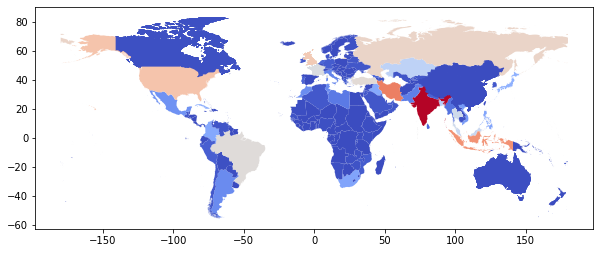

In [21]:
# ploting the world based on the 'New cases' column
df2 = gdf[merge['Date']=='2021-08-01']
df2.plot(column='New cases', figsize=(10,20),cmap='coolwarm');

In [23]:
fig = px.density_mapbox(gdf,lat='Lat',lon="Long",z='New cases',radius=10,
                        center=dict(lat=0, lon=0), zoom=0,
                        mapbox_style="stamen-terrain")

fig.show()

In [24]:
# # heatmap with time 
# heatmap_confirmed = folium.Map(location=[0, 0], tiles= "CartoDB Dark_Matter",min_zoom=2, zoom_start=2, max_zoom=3)

# heatmap_data = gdf
# heatmap_data['Lat'] = heatmap_data['Lat'].astype(float)
# heatmap_data['Long'] = heatmap_data['Long'].astype(float)
# heatmap_data['New cases'] = heatmap_data['New cases'] / heatmap_data['New cases'].sum()
# heatmap_data = heatmap_data[['Country','Lat', 'Long','New cases','Date']]


# # heatmap_data['Date'] = heatmap_data['Date'].sort_values(ascending=True)
# data = []
# for _, d in heatmap_data.groupby('Date'):
#    data.append([[row['Lat'], row['Long'], row['New cases']] for _, row in d.iterrows()])
# hm = plugins.HeatMapWithTime(data , index=heatmap_data['Date'] ,auto_play=True,max_opacity=0.8)
# hm.add_to(heatmap_confirmed)
# heatmap_confirmed

In [25]:
# # adding the shapefile to a folium map object 
# ## folium turns the shapefile to a geojson automatic

# # adding map layers
# mapper = folium.Map(location=[0,0], tiles='CartoDB Dark_Matter',zoom_start=1.5)
# new_cases = folium.Choropleth(  geo_data=df2,
#                                 name='New cases',
#                                 data=df2,
#                                 key_on='feature.properties.Country',
#                                 columns=['Country','New cases'],
#                                 fill_color='YlGn',
#                                 fill_opacity=0.7)
# new_cases.geojson.add_child(folium.features.GeoJsonTooltip(['Country','New cases']))
# new_cases.add_to(mapper)

# recovered = folium.Choropleth(geo_data=df2,
#                               name='Recovered',
#                               data=df2,
#                               key_on='feature.properties.Country',
#                               columns=['Country','Recovered'],
#                               fill_color='YlGn',
#                               fill_opacity=0.7,
#                               line_opacity=1.0,
#                               show=False)
# recovered.geojson.add_child(folium.features.GeoJsonTooltip(['Country','Recovered']))
# recovered.add_to(mapper)

# folium.Choropleth(geo_data=df2,
#                   name='New deaths',
#                   data=df2,
#                   key_on='feature.properties.Country',
#                   columns=['Country','New deaths'],
#                   fill_color='OrRd',
#                   fill_opacity=0.7,
#                   line_opacity=1.0,
#                   show=False).add_to(mapper)

# folium.Choropleth(geo_data=df2,
#                   name='total deaths',
#                   data=df2,
#                   key_on='feature.properties.Country',
#                   columns=['Country','Deaths'],
#                   fill_color='PuRd',
#                   fill_opacity=0.7,
#                   line_opacity=1.0,
#                   show=False).add_to(mapper)

# folium.LayerControl().add_to(mapper)

# mapper.save('map_covid19.html')
# mapper